# Import Library

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# EDA

In [2]:
data = pd.read_csv('greater_melb_020425.csv')
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 454250 entries, 0 to 454249
Data columns (total 23 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   id                     454250 non-null  int64  
 1   address_complete       454250 non-null  object 
 2   address_first_line     454250 non-null  object 
 3   address_street_number  437901 non-null  float64
 4   address_street         454250 non-null  object 
 5   suburb                 454250 non-null  object 
 6   council_area           454250 non-null  object 
 7   street                 454250 non-null  object 
 8   postcode               454250 non-null  int64  
 9   lat                    454215 non-null  float64
 10  long                   454215 non-null  float64
 11  property_type          454250 non-null  object 
 12  occupancy_type         397712 non-null  object 
 13  development_zone       416998 non-null  object 
 14  land_area              454219 non-nu

In [3]:
data.sample(3)

,id,address_complete,address_first_line,address_street_number,address_street,suburb,council_area,street,postcode,lat,...,development_zone,land_area,floor_area,land_use,beds,baths,sales_price,year_built,last_sale_date,agency
238016,16319746,1/1 REX AVENUE ALPHINGTON VIC 3078,1/1 REX AVENUE,1.0,REX AVENUE,ALPHINGTON,YARRA,VIC,3078,-37.785950,...,Neighbourhood Residential Zone - Schedule 2,2612.0,91.0,Strata Unit or Flat (Unspecified),2.0,2.0,685000.0,2012.0,2013-07-04,NaN
78447,11266706,1/94 WARRINGA CRESCENT HOPPERS CROSSING VIC 3029,1/94 WARRINGA CRESCENT,94.0,WARRINGA CRESCENT,HOPPERS CROSSING,WYNDHAM,VIC,3029,-37.883540,...,General Residential Zone - Schedule 1,268.0,102.0,Single Strata Unit,2.0,1.0,355000.0,1992.0,2019-05-22,Barry Plant Werribee
362938,43958590,20-22 MAROO STREET HUGHESDALE VIC 3166,20-22 MAROO STREET,20.0,MAROO STREET,HUGHESDALE,MONASH,VIC,3166,-37.890488,...,General Residential Zone - Schedule 2,310.0,NaN,Single Strata Unit/Villa Unit/Townhouse,NaN,NaN,NaN,NaN,NaN,NaN


In [4]:
data.columns

Index(['id', 'address_complete', 'address_first_line', 'address_street_number',
       'address_street', 'suburb', 'council_area', 'street', 'postcode', 'lat',
       'long', 'property_type', 'occupancy_type', 'development_zone',
       'land_area', 'floor_area', 'land_use', 'beds', 'baths', 'sales_price',
       'year_built', 'last_sale_date', 'agency'],
      dtype='object')

In [5]:
data.shape

(454250, 23)

## Explore Columns and Row

In [6]:
data['council_area'].value_counts()

council_area
MELBOURNE             95798
STONNINGTON           35166
PORT PHILLIP          30116
BOROONDARA            28133
MERRI-BEK             21165
WHITEHORSE            20140
MONASH                20003
GLEN EIRA             18602
MOONEE VALLEY         17401
YARRA                 16587
GREATER DANDENONG     15386
MARIBYRNONG           15159
KINGSTON              14841
DAREBIN               13499
MANNINGHAM            12929
KNOX                  11905
BANYULE               11474
BAYSIDE                8202
MAROONDAH              7871
WHITTLESEA             6521
HUME                   6299
GREATER GEELONG        6063
WYNDHAM                4258
CASEY                  3870
YARRA RANGES           2612
NILLUMBIK              2364
HOBSONS BAY            1969
FRANKSTON              1889
SURF COAST             1087
LATROBE                 622
MELTON                  595
MANSFIELD               290
CARDINIA                268
MACEDON RANGES          223
QUEENSCLIFFE            187
GREATER

In [7]:
#Filter Only Necessary Data for Analysis
data_ready = data[(data.council_area == 'MELBOURNE') | (data.council_area == 'GREATER DANDENONG') |
                 (data.council_area == 'MANNINGHAM')| (data.council_area == 'MARIBYRNONG') |
                 (data.council_area == 'BOROONDARA') | (data.council_area == 'MOONEE VALLEY') |
                 (data.council_area == 'MERRI-BEK') | (data.council_area == 'PORT PHILLIP') |
                 (data.council_area == 'STONNINGTON') | (data.council_area == 'YARRA')]
data_ready = data_ready.reset_index().drop('index',axis=1)
data_ready

,id,address_complete,address_first_line,address_street_number,address_street,suburb,council_area,street,postcode,lat,...,development_zone,land_area,floor_area,land_use,beds,baths,sales_price,year_built,last_sale_date,agency
0,9176677,7/123 BEACONSFIELD PARADE ALBERT PARK VIC 3206,7/123 BEACONSFIELD PARADE,123.0,BEACONSFIELD PARADE,ALBERT PARK,PORT PHILLIP,VIC,3206,-37.848595,...,General Residential Zone - Schedule 2,1468.0,80.0,Strata Unit or Flat (Unspecified),1.0,1.0,750000.0,1888.0,2011-03-28,NaN
1,9176679,8/123 BEACONSFIELD PARADE ALBERT PARK VIC 3206,8/123 BEACONSFIELD PARADE,123.0,BEACONSFIELD PARADE,ALBERT PARK,PORT PHILLIP,VIC,3206,-37.848595,...,General Residential Zone - Schedule 2,1468.0,162.0,Strata Unit or Flat (Unspecified),2.0,2.0,1575000.0,1880.0,2011-09-10,Abercromby's Real Estate
2,9176681,9/123 BEACONSFIELD PARADE ALBERT PARK VIC 3206,9/123 BEACONSFIELD PARADE,123.0,BEACONSFIELD PARADE,ALBERT PARK,PORT PHILLIP,VIC,3206,-37.848595,...,General Residential Zone - Schedule 2,1468.0,140.0,Strata Unit or Flat (Unspecified),2.0,2.0,1575000.0,1888.0,2011-09-10,NaN
3,9176683,10/123 BEACONSFIELD PARADE ALBERT PARK VIC 3206,10/123 BEACONSFIELD PARADE,123.0,BEACONSFIELD PARADE,ALBERT PARK,PORT PHILLIP,VIC,3206,-37.848595,...,General Residential Zone - Schedule 2,1468.0,153.0,Strata Unit or Flat (Unspecified),2.0,2.0,575000.0,1900.0,2004-07-29,NaN
4,9176687,12/123 BEACONSFIELD PARADE ALBERT PARK VIC 3206,12/123 BEACONSFIELD PARADE,123.0,BEACONSFIELD PARADE,ALBERT PARK,PORT PHILLIP,VIC,3206,-37.848595,...,General Residential Zone - Schedule 2,1468.0,101.0,Strata Unit or Flat (Unspecified),1.0,1.0,1565000.0,1900.0,2016-04-09,Marshall White Real Estate
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
287835,9176650,13/122 BEACONSFIELD PARADE ALBERT PARK VIC 3206,13/122 BEACONSFIELD PARADE,122.0,BEACONSFIELD PARADE,ALBERT PARK,PORT PHILLIP,VIC,3206,-37.848500,...,General Residential Zone - Schedule 2,837.0,NaN,Strata Unit or Flat (Unspecified),1.0,1.0,395000.0,NaN,2002-07-03,NaN
287836,9176654,4/122 BEACONSFIELD PARADE ALBERT PARK VIC 3206,4/122 BEACONSFIELD PARADE,122.0,BEACONSFIELD PARADE,ALBERT PARK,PORT PHILLIP,VIC,3206,-37.848500,...,General Residential Zone - Schedule 2,837.0,60.0,Strata Unit or Flat (Unspecified),1.0,1.0,347000.0,1980.0,2007-12-11,Half A Percent Real Estate
287837,9176662,8/122 BEACONSFIELD PARADE ALBERT PARK VIC 3206,8/122 BEACONSFIELD PARADE,122.0,BEACONSFIELD PARADE,ALBERT PARK,PORT PHILLIP,VIC,3206,-37.848500,...,General Residential Zone - Schedule 2,837.0,NaN,Strata Unit or Flat (Unspecified),1.0,1.0,345000.0,1965.0,2009-12-17,NaN
287838,9176664,15/122 BEACONSFIELD PARADE ALBERT PARK VIC 3206,15/122 BEACONSFIELD PARADE,122.0,BEACONSFIELD PARADE,ALBERT PARK,PORT PHILLIP,VIC,3206,-37.848500,...,General Residential Zone - Schedule 2,837.0,NaN,Strata Unit or Flat (Unspecified),1.0,1.0,245000.0,1965.0,2005-05-13,NaN


In [8]:
data_ready.isnull().sum()

id                            0
address_complete              0
address_first_line            0
address_street_number      9933
address_street                0
suburb                        0
council_area                  0
street                        0
postcode                      0
lat                           0
long                          0
property_type                 0
occupancy_type            27265
development_zone          25173
land_area                    17
floor_area                77765
land_use                      0
beds                      39897
baths                     52725
sales_price               13752
year_built                44099
last_sale_date            13752
agency                   174737
dtype: int64

In [9]:
# Drop Column
data_ready = data_ready.drop(['id','last_sale_date','agency'],axis=1)

In [10]:
data_ready[data_ready.council_area == 'MANNINGHAM']

,address_complete,address_first_line,address_street_number,address_street,suburb,council_area,street,postcode,lat,long,property_type,occupancy_type,development_zone,land_area,floor_area,land_use,beds,baths,sales_price,year_built
9151,18 ALFREDA AVENUE BULLEEN VIC 3105,18 ALFREDA AVENUE,18.0,ALFREDA AVENUE,BULLEEN,MANNINGHAM,VIC,3105,-37.778150,145.09740,UNIT,Rented,General Residential Zone - Schedule 1,448.0,225.0,Single Strata Unit/Villa Unit/Townhouse,3.0,1.0,524500.0,NaN
9152,20 ALFREDA AVENUE BULLEEN VIC 3105,20 ALFREDA AVENUE,20.0,ALFREDA AVENUE,BULLEEN,MANNINGHAM,VIC,3105,-37.778020,145.09747,UNIT,Owner Occupied,General Residential Zone - Schedule 1,378.0,114.0,Strata Unit or Flat (Unspecified),3.0,NaN,124100.0,NaN
9153,22 ALFREDA AVENUE BULLEEN VIC 3105,22 ALFREDA AVENUE,22.0,ALFREDA AVENUE,BULLEEN,MANNINGHAM,VIC,3105,-37.777890,145.09756,HOUSE,Owner Occupied,General Residential Zone - Schedule 1,383.0,NaN,Single Strata Unit/Villa Unit/Townhouse,3.0,1.0,472720.0,NaN
9154,1/15 ALLEN STREET BULLEEN VIC 3105,1/15 ALLEN STREET,15.0,ALLEN STREET,BULLEEN,MANNINGHAM,VIC,3105,-37.776905,145.08786,UNIT,Owner Occupied,General Residential Zone - Schedule 1,246.0,111.0,Single Strata Unit/Villa Unit/Townhouse,3.0,1.0,845000.0,1999.0
9155,2/15 ALLEN STREET BULLEEN VIC 3105,2/15 ALLEN STREET,15.0,ALLEN STREET,BULLEEN,MANNINGHAM,VIC,3105,-37.776905,145.08786,UNIT,Owner Occupied,General Residential Zone - Schedule 1,183.0,86.0,Single Strata Unit/Villa Unit/Townhouse,2.0,1.0,747000.0,2000.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
286563,210/777 DONCASTER ROAD DONCASTER VIC 3108,210/777 DONCASTER ROAD,777.0,DONCASTER ROAD,DONCASTER,MANNINGHAM,VIC,3108,-37.786266,145.13638,UNIT,Owner Occupied,NaN,2096.0,NaN,Strata Unit or Flat (Unspecified),1.0,2.0,615000.0,NaN
286564,301/777 DONCASTER ROAD DONCASTER VIC 3108,301/777 DONCASTER ROAD,777.0,DONCASTER ROAD,DONCASTER,MANNINGHAM,VIC,3108,-37.786266,145.13638,UNIT,Owner Occupied,NaN,2096.0,NaN,Strata Unit or Flat (Unspecified),2.0,NaN,1500000.0,NaN
286565,302/777 DONCASTER ROAD DONCASTER VIC 3108,302/777 DONCASTER ROAD,777.0,DONCASTER ROAD,DONCASTER,MANNINGHAM,VIC,3108,-37.786266,145.13638,OTHER,NaN,NaN,2096.0,NaN,Strata Unit or Flat (Unspecified),NaN,NaN,1499000.0,NaN
286566,303/777 DONCASTER ROAD DONCASTER VIC 3108,303/777 DONCASTER ROAD,777.0,DONCASTER ROAD,DONCASTER,MANNINGHAM,VIC,3108,-37.786266,145.13638,OTHER,NaN,NaN,2096.0,NaN,Strata Unit or Flat (Unspecified),NaN,NaN,1272385.0,NaN


In [11]:
#Suburb Count
data_ready['suburb'].unique()

array(['ALBERT PARK', 'MIDDLE PARK', 'ST KILDA WEST', 'ST KILDA',
       'SOUTH MELBOURNE', 'MELBOURNE', 'HAWTHORN', 'ALPHINGTON', 'KEW',
       'KINGSVILLE', 'ARMADALE', 'TOORAK', 'MALVERN EAST', 'WINDSOR',
       'PRAHRAN', 'MALVERN', 'GLEN IRIS', 'ASCOT VALE', 'FLEMINGTON',
       'MOONEE PONDS', 'TRAVANCORE', 'ASHBURTON', 'EAST MELBOURNE',
       'SOUTHBANK', 'AVONDALE HEIGHTS', 'KEILOR EAST', 'BALACLAVA',
       'ST KILDA EAST', 'RIPPONLEA', 'DEEPDENE', 'BALWYN', 'BALWYN NORTH',
       'HAWTHORN EAST', 'SURREY HILLS', 'CARLTON NORTH', 'ESSENDON',
       'PORT MELBOURNE', 'NOBLE PARK', 'HADFIELD', 'BRAYBROOK',
       'BRUNSWICK', 'BRUNSWICK EAST', 'BRUNSWICK WEST', 'DANDENONG',
       'FITZROY', 'OAK PARK', 'FITZROY NORTH', 'COBURG', 'GLENROY',
       'BULLEEN', 'DONCASTER EAST', 'DONCASTER', 'BURNLEY', 'RICHMOND',
       'CAMBERWELL', 'CARLTON', 'CANTERBURY', 'NORTH MELBOURNE',
       'PRINCES HILL', 'FOOTSCRAY', 'CLIFTON HILL', 'PASCOE VALE SOUTH',
       'COBURG NORTH', 'PASCOE 

In [12]:
data_ready['council_area'].value_counts()

council_area
MELBOURNE            95798
STONNINGTON          35166
PORT PHILLIP         30116
BOROONDARA           28133
MERRI-BEK            21165
MOONEE VALLEY        17401
YARRA                16587
GREATER DANDENONG    15386
MARIBYRNONG          15159
MANNINGHAM           12929
Name: count, dtype: int64

# Cleansing

## Missing Data

In [13]:
data_ready['occupancy_type'].value_counts()

occupancy_type
Rented                       202484
Owner Occupied                56763
Government Owned - Other       1171
Government Owned - Rented       157
Name: count, dtype: int64

In [14]:
data_ready.isnull().sum()

address_complete             0
address_first_line           0
address_street_number     9933
address_street               0
suburb                       0
council_area                 0
street                       0
postcode                     0
lat                          0
long                         0
property_type                0
occupancy_type           27265
development_zone         25173
land_area                   17
floor_area               77765
land_use                     0
beds                     39897
baths                    52725
sales_price              13752
year_built               44099
dtype: int64

<Axes: >

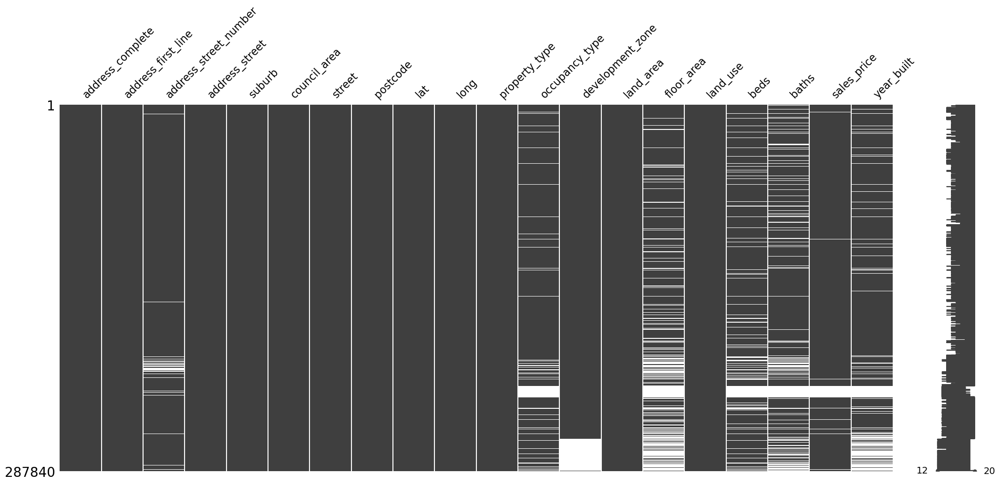

In [15]:
import missingno as msno
%matplotlib inline
msno.matrix(data_ready)

In [16]:
# Count City Council-missing adress street number
data_ready[data_ready['address_street_number'].isna()]['council_area'].value_counts()

council_area
STONNINGTON          2230
BOROONDARA           1752
MOONEE VALLEY        1388
YARRA                1053
GREATER DANDENONG     996
MARIBYRNONG           760
MERRI-BEK             758
PORT PHILLIP          452
MELBOURNE             427
MANNINGHAM            117
Name: count, dtype: int64

In [17]:
data_ready[data_ready['occupancy_type'].isna()]['council_area'].value_counts()

council_area
MELBOURNE            6770
BOROONDARA           3612
STONNINGTON          3123
GREATER DANDENONG    2631
PORT PHILLIP         2549
MERRI-BEK            2180
MOONEE VALLEY        2133
MANNINGHAM           1987
MARIBYRNONG          1275
YARRA                1005
Name: count, dtype: int64

In [18]:
data_ready[data_ready['development_zone'].isna()]['council_area'].value_counts()

council_area
MELBOURNE            9830
MARIBYRNONG          2599
MERRI-BEK            2439
PORT PHILLIP         2238
MOONEE VALLEY        1704
YARRA                1587
STONNINGTON          1503
BOROONDARA           1305
MANNINGHAM           1217
GREATER DANDENONG     751
Name: count, dtype: int64

In [19]:
## Filter data based on missing street number
data_ready[data_ready['address_street_number'].isna()]

,address_complete,address_first_line,address_street_number,address_street,suburb,council_area,street,postcode,lat,long,property_type,occupancy_type,development_zone,land_area,floor_area,land_use,beds,baths,sales_price,year_built
179,ADAMS STREET ALPHINGTON VIC 3078,ADAMS STREET,NaN,ADAMS STREET,ALPHINGTON,YARRA,VIC,3078,-37.782200,145.03268,UNIT,Owner Occupied,Neighbourhood Residential Zone - Schedule 2,629.0,55.0,Strata Unit or Flat (Unspecified),1.0,1.0,447000.0,1970.0
246,ST BERNARDS ROAD ALPHINGTON VIC 3078,ST BERNARDS ROAD,NaN,ST BERNARDS ROAD,ALPHINGTON,YARRA,VIC,3078,-37.782673,145.03514,UNIT,Rented,Neighbourhood Residential Zone - Schedule 2,1274.0,NaN,Strata Unit or Flat (Unspecified),NaN,NaN,75000.0,1970.0
1325,NORTHCOTE ROAD ARMADALE VIC 3143,NORTHCOTE ROAD,NaN,NORTHCOTE ROAD,ARMADALE,STONNINGTON,VIC,3143,-37.853065,145.01657,UNIT,Owner Occupied,Neighbourhood Residential Zone - Schedule 2,768.0,NaN,Strata Unit or Flat (Unspecified),1.0,1.0,350000.0,1964.0
1380,ORRONG ROAD ARMADALE VIC 3143,ORRONG ROAD,NaN,ORRONG ROAD,ARMADALE,STONNINGTON,VIC,3143,-37.853670,145.01130,UNIT,Rented,Residential Growth Zone - Schedule 1,644.0,54.0,Strata Unit or Flat (Unspecified),2.0,1.0,0.0,1970.0
1381,ORRONG ROAD ARMADALE VIC 3143,ORRONG ROAD,NaN,ORRONG ROAD,ARMADALE,STONNINGTON,VIC,3143,-37.853670,145.01130,UNIT,Rented,Residential Growth Zone - Schedule 1,644.0,54.0,Single Strata Unit/Villa Unit/Townhouse,1.0,1.0,370000.0,1970.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
287380,HUDSON STREET COBURG VIC 3058,HUDSON STREET,NaN,HUDSON STREET,COBURG,MERRI-BEK,VIC,3058,-37.743380,144.96250,OTHER,NaN,NaN,187.0,NaN,Strata Unit or Flat (Unspecified),NaN,NaN,NaN,NaN
287381,REYNOLDS PARADE PASCOE VALE SOUTH VIC 3044,REYNOLDS PARADE,NaN,REYNOLDS PARADE,PASCOE VALE SOUTH,MERRI-BEK,VIC,3044,-37.740704,144.93962,OTHER,NaN,NaN,303.0,NaN,Single Strata Unit/Villa Unit/Townhouse,NaN,NaN,NaN,NaN
287406,LOT 13 ABBOTSFORD STREET ABBOTSFORD VIC 3067,LOT 13 ABBOTSFORD STREET,NaN,ABBOTSFORD STREET,ABBOTSFORD,YARRA,VIC,3067,-37.801590,144.99916,FLATS,Owner Occupied,Neighbourhood Residential Zone - Schedule 1,607.0,NaN,Strata Unit or Flat (Unspecified),NaN,NaN,325000.0,1970.0
287517,NICHOLSON STREET ABBOTSFORD VIC 3067,NICHOLSON STREET,NaN,NICHOLSON STREET,ABBOTSFORD,YARRA,VIC,3067,-37.800743,144.99728,UNIT,Rented,General Residential Zone - Schedule 2,327.0,NaN,Strata Unit or Flat (Unspecified),1.0,1.0,225000.0,1970.0


In [20]:
#Check duplicated data
data_ready.duplicated().sum()

527

## Drop Duplicated Data and Missing Data

In [21]:
data_ready = data_ready.drop_duplicates()
data_ready.info()

<class 'pandas.core.frame.DataFrame'>
Index: 287313 entries, 0 to 287839
Data columns (total 20 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   address_complete       287313 non-null  object 
 1   address_first_line     287313 non-null  object 
 2   address_street_number  277803 non-null  float64
 3   address_street         287313 non-null  object 
 4   suburb                 287313 non-null  object 
 5   council_area           287313 non-null  object 
 6   street                 287313 non-null  object 
 7   postcode               287313 non-null  int64  
 8   lat                    287313 non-null  float64
 9   long                   287313 non-null  float64
 10  property_type          287313 non-null  object 
 11  occupancy_type         260072 non-null  object 
 12  development_zone       262273 non-null  object 
 13  land_area              287296 non-null  float64
 14  floor_area             209965 non-null  f

In [22]:
data_ready = data_ready.dropna()
data_ready.info()

<class 'pandas.core.frame.DataFrame'>
Index: 176572 entries, 0 to 287839
Data columns (total 20 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   address_complete       176572 non-null  object 
 1   address_first_line     176572 non-null  object 
 2   address_street_number  176572 non-null  float64
 3   address_street         176572 non-null  object 
 4   suburb                 176572 non-null  object 
 5   council_area           176572 non-null  object 
 6   street                 176572 non-null  object 
 7   postcode               176572 non-null  int64  
 8   lat                    176572 non-null  float64
 9   long                   176572 non-null  float64
 10  property_type          176572 non-null  object 
 11  occupancy_type         176572 non-null  object 
 12  development_zone       176572 non-null  object 
 13  land_area              176572 non-null  float64
 14  floor_area             176572 non-null  f

In [23]:
data_ready['address_street_number'] = data_ready['address_street_number'].astype(int)
data_ready['sales_price'] = data_ready['sales_price'].astype(int)
data_ready['year_built'] = data_ready['year_built'].astype(int)
data_ready.info()

<class 'pandas.core.frame.DataFrame'>
Index: 176572 entries, 0 to 287839
Data columns (total 20 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   address_complete       176572 non-null  object 
 1   address_first_line     176572 non-null  object 
 2   address_street_number  176572 non-null  int32  
 3   address_street         176572 non-null  object 
 4   suburb                 176572 non-null  object 
 5   council_area           176572 non-null  object 
 6   street                 176572 non-null  object 
 7   postcode               176572 non-null  int64  
 8   lat                    176572 non-null  float64
 9   long                   176572 non-null  float64
 10  property_type          176572 non-null  object 
 11  occupancy_type         176572 non-null  object 
 12  development_zone       176572 non-null  object 
 13  land_area              176572 non-null  float64
 14  floor_area             176572 non-null  f

## Exploratory Data Analysis (after cleansing)

<Axes: xlabel='occupancy_type'>

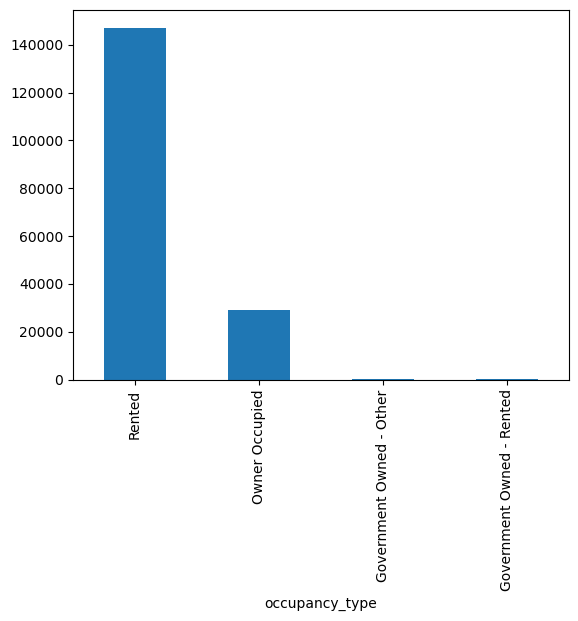

In [24]:
data_ready['occupancy_type'].value_counts().plot.bar()

In [25]:
data_ready['development_zone'].unique()

array(['General Residential Zone - Schedule 2',
       'Residential Growth Zone - Schedule 1', 'Commercial 1 Zone',
       'Neighbourhood Residential Zone - Schedule 1',
       'General Residential Zone - Schedule 1',
       'Neighbourhood Residential Zone - Schedule 5',
       'Neighbourhood Residential Zone - Schedule 2',
       'General Residential Zone - Schedule 10',
       'Residential Growth Zone - Schedule 2',
       'General Residential Zone - Schedule 14',
       'General Residential Zone - Schedule 3',
       'Neighbourhood Residential Zone - Schedule 3',
       'Residential Growth Zone - Schedule 3', 'General Residential Zone',
       'Mixed Use Zone', 'General Residential Zone - Schedule 5',
       'Capital City Zone - Schedule 3',
       'Neighbourhood Residential Zone - Schedule 6',
       'General Residential Zone - Schedule 4',
       'Capital City Zone - Schedule 5', 'Capital City Zone - Schedule 1',
       'General Residential Zone - Schedule 7',
       'Activity Cen

In [26]:
data_ready["development_zone_base"] = data_ready["development_zone"].str.extract(r"^(.*?)(?:\s*-\s*.*)?$")

data_ready["development_zone_base"].unique()

array(['General Residential Zone', 'Residential Growth Zone',
       'Commercial 1 Zone', 'Neighbourhood Residential Zone',
       'Mixed Use Zone', 'Capital City Zone', 'Activity Centre Zone',
       'Commercial 2 Zone', 'Comprehensive Development Zone',
       'Industrial 1 Zone', 'Docklands Zone', 'Urban Floodway Zone',
       'Low Density Residential Zone', 'Industrial 3 Zone',
       'Special Use Zone', 'Priority Development Zone', 'Public Use Zone',
       'Green Wedge A Zone', 'Public Park and Recreation Zone',
       'Road Zone'], dtype=object)

In [27]:
data_ready["development_zone_base"].value_counts()

development_zone_base
General Residential Zone           56759
Capital City Zone                  31192
Mixed Use Zone                     18896
Commercial 1 Zone                  18392
Neighbourhood Residential Zone     18228
Residential Growth Zone            12093
Activity Centre Zone               10969
Docklands Zone                      7122
Comprehensive Development Zone      2138
Priority Development Zone            596
Industrial 3 Zone                     65
Public Use Zone                       62
Commercial 2 Zone                     44
Low Density Residential Zone           7
Industrial 1 Zone                      4
Urban Floodway Zone                    1
Special Use Zone                       1
Green Wedge A Zone                     1
Public Park and Recreation Zone        1
Road Zone                              1
Name: count, dtype: int64

In [28]:
data_ready["development_zone_base"].unique()

array(['General Residential Zone', 'Residential Growth Zone',
       'Commercial 1 Zone', 'Neighbourhood Residential Zone',
       'Mixed Use Zone', 'Capital City Zone', 'Activity Centre Zone',
       'Commercial 2 Zone', 'Comprehensive Development Zone',
       'Industrial 1 Zone', 'Docklands Zone', 'Urban Floodway Zone',
       'Low Density Residential Zone', 'Industrial 3 Zone',
       'Special Use Zone', 'Priority Development Zone', 'Public Use Zone',
       'Green Wedge A Zone', 'Public Park and Recreation Zone',
       'Road Zone'], dtype=object)

In [29]:
data_ready[data_ready.development_zone_base == 'Capital City Zone']

,address_complete,address_first_line,address_street_number,address_street,suburb,council_area,street,postcode,lat,long,...,occupancy_type,development_zone,land_area,floor_area,land_use,beds,baths,sales_price,year_built,development_zone_base
2908,151/83 WHITEMAN STREET SOUTHBANK VIC 3006,151/83 WHITEMAN STREET,83,WHITEMAN STREET,SOUTHBANK,MELBOURNE,VIC,3006,-37.826977,144.95600,...,Rented,Capital City Zone - Schedule 3,2931.0,86.00,Strata Unit or Flat (Unspecified),2.0,1.0,580000,2002,Capital City Zone
11709,11/18 BARKLY PLACE CARLTON VIC 3053,11/18 BARKLY PLACE,18,BARKLY PLACE,CARLTON,MELBOURNE,VIC,3053,-37.803200,144.96143,...,Rented,Capital City Zone - Schedule 5,288.0,73.00,Strata Unit or Flat (Unspecified),2.0,1.0,269600,2003,Capital City Zone
11710,14/18 BARKLY PLACE CARLTON VIC 3053,14/18 BARKLY PLACE,18,BARKLY PLACE,CARLTON,MELBOURNE,VIC,3053,-37.803200,144.96143,...,Rented,Capital City Zone - Schedule 5,288.0,54.00,Strata Unit or Flat (Unspecified),1.0,1.0,242215,2003,Capital City Zone
11711,21/18 BARKLY PLACE CARLTON VIC 3053,21/18 BARKLY PLACE,18,BARKLY PLACE,CARLTON,MELBOURNE,VIC,3053,-37.803200,144.96143,...,Rented,Capital City Zone - Schedule 5,288.0,73.97,Single Strata Unit/Villa Unit/Townhouse,2.0,1.0,620000,2000,Capital City Zone
11712,22/18 BARKLY PLACE CARLTON VIC 3053,22/18 BARKLY PLACE,18,BARKLY PLACE,CARLTON,MELBOURNE,VIC,3053,-37.803200,144.96143,...,Rented,Capital City Zone - Schedule 5,288.0,75.00,Strata Unit or Flat (Unspecified),2.0,1.0,527000,2002,Capital City Zone
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
262196,2706/81 CITY ROAD SOUTHBANK VIC 3006,2706/81 CITY ROAD,81,CITY ROAD,SOUTHBANK,MELBOURNE,VIC,3006,-37.822407,144.96544,...,Rented,Capital City Zone - Schedule 3,2334.0,86.00,Strata Unit or Flat (Unspecified),2.0,2.0,713000,2022,Capital City Zone
262214,3914/81 CITY ROAD SOUTHBANK VIC 3006,3914/81 CITY ROAD,81,CITY ROAD,SOUTHBANK,MELBOURNE,VIC,3006,-37.822407,144.96544,...,Rented,Capital City Zone - Schedule 3,2334.0,60.00,Strata Unit or Flat (Unspecified),1.0,1.0,575000,2022,Capital City Zone
262230,2406/81 CITY ROAD SOUTHBANK VIC 3006,2406/81 CITY ROAD,81,CITY ROAD,SOUTHBANK,MELBOURNE,VIC,3006,-37.822407,144.96544,...,Rented,Capital City Zone - Schedule 3,2334.0,86.00,Strata Unit or Flat (Unspecified),2.0,2.0,713000,2022,Capital City Zone
262238,1710/81 CITY ROAD SOUTHBANK VIC 3006,1710/81 CITY ROAD,81,CITY ROAD,SOUTHBANK,MELBOURNE,VIC,3006,-37.822407,144.96544,...,Rented,Capital City Zone - Schedule 3,2334.0,100.00,Strata Unit or Flat (Unspecified),3.0,2.0,1070000,2022,Capital City Zone


In [30]:
data_ready[data_ready.suburb == 'DOCKLANDS']

,address_complete,address_first_line,address_street_number,address_street,suburb,council_area,street,postcode,lat,long,...,occupancy_type,development_zone,land_area,floor_area,land_use,beds,baths,sales_price,year_built,development_zone_base
19511,16/801 BOURKE STREET DOCKLANDS VIC 3008,16/801 BOURKE STREET,801,BOURKE STREET,DOCKLANDS,MELBOURNE,VIC,3008,-37.819744,144.94562,...,Rented,Docklands Zone - Schedule 2,2532.0,70.0,Single Strata Unit/Villa Unit/Townhouse,2.0,1.0,570000,2008,Docklands Zone
19512,52/801 BOURKE STREET DOCKLANDS VIC 3008,52/801 BOURKE STREET,801,BOURKE STREET,DOCKLANDS,MELBOURNE,VIC,3008,-37.819744,144.94562,...,Rented,Docklands Zone - Schedule 2,2532.0,70.0,Strata Unit or Flat (Unspecified),2.0,1.0,462500,2008,Docklands Zone
19513,61/801 BOURKE STREET DOCKLANDS VIC 3008,61/801 BOURKE STREET,801,BOURKE STREET,DOCKLANDS,MELBOURNE,VIC,3008,-37.819744,144.94562,...,Owner Occupied,Docklands Zone - Schedule 2,2532.0,92.0,Single Strata Unit/Villa Unit/Townhouse,2.0,2.0,710000,2008,Docklands Zone
19514,64/801 BOURKE STREET DOCKLANDS VIC 3008,64/801 BOURKE STREET,801,BOURKE STREET,DOCKLANDS,MELBOURNE,VIC,3008,-37.819744,144.94562,...,Owner Occupied,Docklands Zone - Schedule 2,2532.0,89.0,Single Strata Unit/Villa Unit/Townhouse,2.0,2.0,652500,2008,Docklands Zone
19515,706/750 BOURKE STREET DOCKLANDS VIC 3008,706/750 BOURKE STREET,750,BOURKE STREET,DOCKLANDS,MELBOURNE,VIC,3008,-37.818172,144.94722,...,Rented,Docklands Zone - Schedule 4,12509.0,76.0,Strata Unit or Flat (Unspecified),2.0,2.0,512000,2005,Docklands Zone
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
252048,937 COLLINS STREET DOCKLANDS VIC 3008,937 COLLINS STREET,937,COLLINS STREET,DOCKLANDS,MELBOURNE,VIC,3008,-37.820610,144.93962,...,Rented,Docklands Zone - Schedule 2,4467.0,191.0,Strata Unit or Flat (Unspecified),3.0,4.0,2800000,2019,Docklands Zone
252050,933 COLLINS STREET DOCKLANDS VIC 3008,933 COLLINS STREET,933,COLLINS STREET,DOCKLANDS,MELBOURNE,VIC,3008,-37.820610,144.93962,...,Rented,Docklands Zone - Schedule 2,4467.0,200.0,Conjoined Strata Unit/Townhouse,3.0,3.0,2600000,2018,Docklands Zone
252051,931 COLLINS STREET DOCKLANDS VIC 3008,931 COLLINS STREET,931,COLLINS STREET,DOCKLANDS,MELBOURNE,VIC,3008,-37.820610,144.93962,...,Rented,Docklands Zone - Schedule 2,4467.0,66.0,Strata Unit or Flat (Unspecified),2.0,1.0,2600000,2018,Docklands Zone
252055,921 COLLINS STREET DOCKLANDS VIC 3008,921 COLLINS STREET,921,COLLINS STREET,DOCKLANDS,MELBOURNE,VIC,3008,-37.820610,144.93962,...,Rented,Docklands Zone - Schedule 2,4467.0,192.0,Conjoined Strata Unit/Townhouse,3.0,3.0,2700000,2019,Docklands Zone


In [31]:
data_ready[data_ready['sales_price'].isna()]['council_area'].value_counts()

Series([], Name: count, dtype: int64)

In [32]:
data_ready[data_ready['year_built'].isna()]['council_area'].value_counts()

Series([], Name: count, dtype: int64)

In [33]:
data_ready['land_use'].unique()

array(['Strata Unit or Flat  (Unspecified)', 'OYO Strata Flat',
       'Single Strata Unit/Villa Unit/Townhouse',
       'Strata/Subdivided Office', 'Single Strata Unit',
       'Conjoined Strata Unit/Townhouse', 'Strata Dwelling',
       'Conjoined Strata Unit', 'Strata unit or flat'], dtype=object)

<Axes: xlabel='land_use'>

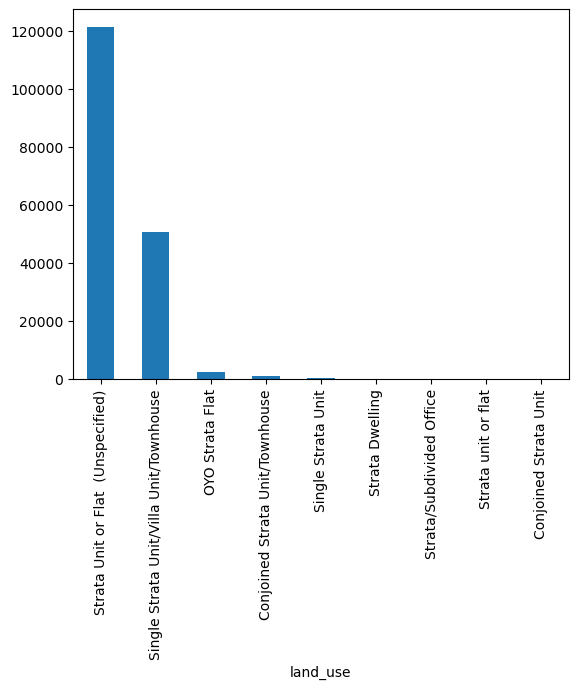

In [34]:
data_ready['land_use'].value_counts().plot.bar()

<Axes: xlabel='property_type'>

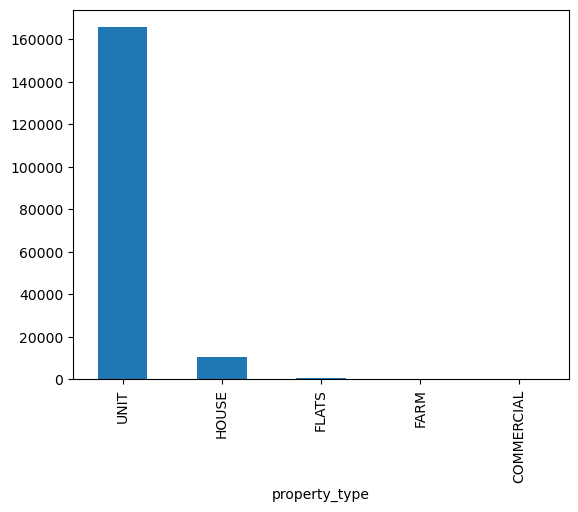

In [35]:
data_ready['property_type'].value_counts().plot.bar()

## Feature Engineering

In [36]:
data_ready[['council_area','suburb']].value_counts()

council_area  suburb         
MELBOURNE     MELBOURNE          21210
              SOUTHBANK          12446
STONNINGTON   SOUTH YARRA         8074
MELBOURNE     DOCKLANDS           7476
              CARLTON             5189
                                 ...  
              SOUTH WHARF            8
MANNINGHAM    WONGA PARK             5
MELBOURNE     PORT MELBOURNE         5
MANNINGHAM    PARK ORCHARDS          4
MELBOURNE     SOUTH MELBOURNE        1
Name: count, Length: 112, dtype: int64

### Get Development Zone

In [37]:
data_ready["full_address"] = data_ready["address_street_number"].astype(str).str.strip() + " " + data_ready["address_street"].str.strip() + ", " + data_ready["suburb"].str.strip()
data_ready

,address_complete,address_first_line,address_street_number,address_street,suburb,council_area,street,postcode,lat,long,...,development_zone,land_area,floor_area,land_use,beds,baths,sales_price,year_built,development_zone_base,full_address
0,7/123 BEACONSFIELD PARADE ALBERT PARK VIC 3206,7/123 BEACONSFIELD PARADE,123,BEACONSFIELD PARADE,ALBERT PARK,PORT PHILLIP,VIC,3206,-37.848595,144.95125,...,General Residential Zone - Schedule 2,1468.0,80.0,Strata Unit or Flat (Unspecified),1.0,1.0,750000,1888,General Residential Zone,"123 BEACONSFIELD PARADE, ALBERT PARK"
1,8/123 BEACONSFIELD PARADE ALBERT PARK VIC 3206,8/123 BEACONSFIELD PARADE,123,BEACONSFIELD PARADE,ALBERT PARK,PORT PHILLIP,VIC,3206,-37.848595,144.95125,...,General Residential Zone - Schedule 2,1468.0,162.0,Strata Unit or Flat (Unspecified),2.0,2.0,1575000,1880,General Residential Zone,"123 BEACONSFIELD PARADE, ALBERT PARK"
2,9/123 BEACONSFIELD PARADE ALBERT PARK VIC 3206,9/123 BEACONSFIELD PARADE,123,BEACONSFIELD PARADE,ALBERT PARK,PORT PHILLIP,VIC,3206,-37.848595,144.95125,...,General Residential Zone - Schedule 2,1468.0,140.0,Strata Unit or Flat (Unspecified),2.0,2.0,1575000,1888,General Residential Zone,"123 BEACONSFIELD PARADE, ALBERT PARK"
3,10/123 BEACONSFIELD PARADE ALBERT PARK VIC 3206,10/123 BEACONSFIELD PARADE,123,BEACONSFIELD PARADE,ALBERT PARK,PORT PHILLIP,VIC,3206,-37.848595,144.95125,...,General Residential Zone - Schedule 2,1468.0,153.0,Strata Unit or Flat (Unspecified),2.0,2.0,575000,1900,General Residential Zone,"123 BEACONSFIELD PARADE, ALBERT PARK"
4,12/123 BEACONSFIELD PARADE ALBERT PARK VIC 3206,12/123 BEACONSFIELD PARADE,123,BEACONSFIELD PARADE,ALBERT PARK,PORT PHILLIP,VIC,3206,-37.848595,144.95125,...,General Residential Zone - Schedule 2,1468.0,101.0,Strata Unit or Flat (Unspecified),1.0,1.0,1565000,1900,General Residential Zone,"123 BEACONSFIELD PARADE, ALBERT PARK"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
287829,10/110 BEACONSFIELD PARADE ALBERT PARK VIC 3206,10/110 BEACONSFIELD PARADE,110,BEACONSFIELD PARADE,ALBERT PARK,PORT PHILLIP,VIC,3206,-37.847946,144.94981,...,General Residential Zone - Schedule 2,753.0,102.0,Strata Unit or Flat (Unspecified),3.0,2.0,3680000,2000,General Residential Zone,"110 BEACONSFIELD PARADE, ALBERT PARK"
287830,3/110 BEACONSFIELD PARADE ALBERT PARK VIC 3206,3/110 BEACONSFIELD PARADE,110,BEACONSFIELD PARADE,ALBERT PARK,PORT PHILLIP,VIC,3206,-37.847946,144.94981,...,General Residential Zone - Schedule 2,753.0,94.0,Strata Unit or Flat (Unspecified),2.0,2.0,1505000,1998,General Residential Zone,"110 BEACONSFIELD PARADE, ALBERT PARK"
287831,17/122 BEACONSFIELD PARADE ALBERT PARK VIC 3206,17/122 BEACONSFIELD PARADE,122,BEACONSFIELD PARADE,ALBERT PARK,PORT PHILLIP,VIC,3206,-37.848500,144.95097,...,General Residential Zone - Schedule 2,837.0,38.3,Strata Unit or Flat (Unspecified),1.0,1.0,355000,1970,General Residential Zone,"122 BEACONSFIELD PARADE, ALBERT PARK"
287836,4/122 BEACONSFIELD PARADE ALBERT PARK VIC 3206,4/122 BEACONSFIELD PARADE,122,BEACONSFIELD PARADE,ALBERT PARK,PORT PHILLIP,VIC,3206,-37.848500,144.95097,...,General Residential Zone - Schedule 2,837.0,60.0,Strata Unit or Flat (Unspecified),1.0,1.0,347000,1980,General Residential Zone,"122 BEACONSFIELD PARADE, ALBERT PARK"


### Dividing Land Area

In [38]:
# Define 3-bin percentile cut points
cut_points = np.percentile(data_ready['land_area'], [0, 33.33, 66.66, 100])

# Check where the cuts are
print("Cut points:", cut_points)

# Define 3 labels
price_labels = ['small_area', 'medium_area', 'large_area']

# Apply the binning
data_ready['land_size_group'] = pd.cut(
    data_ready['land_area'],
    bins=cut_points,
    labels=price_labels,
    include_lowest=True
)

# Preview sample
data_ready.sample(5)

Cut points: [     0.    837.   2113. 103652.]


,address_complete,address_first_line,address_street_number,address_street,suburb,council_area,street,postcode,lat,long,...,land_area,floor_area,land_use,beds,baths,sales_price,year_built,development_zone_base,full_address,land_size_group
117105,2/15 DENBIGH ROAD ARMADALE VIC 3143,2/15 DENBIGH ROAD,15,DENBIGH ROAD,ARMADALE,STONNINGTON,VIC,3143,-37.858740,145.01514,...,1173.0,93.0,Strata Unit or Flat (Unspecified),3.0,2.0,930000,1969,General Residential Zone,"15 DENBIGH ROAD, ARMADALE",medium_area
144123,3/222 WILLIAMSONS ROAD DONCASTER VIC 3108,3/222 WILLIAMSONS ROAD,222,WILLIAMSONS ROAD,DONCASTER,MANNINGHAM,VIC,3108,-37.768390,145.13136,...,148.0,105.0,Single Strata Unit/Villa Unit/Townhouse,3.0,2.0,895000,2015,General Residential Zone,"222 WILLIAMSONS ROAD, DONCASTER",small_area
64414,9/267 ASCOT VALE ROAD MOONEE PONDS VIC 3039,9/267 ASCOT VALE ROAD,267,ASCOT VALE ROAD,MOONEE PONDS,MOONEE VALLEY,VIC,3039,-37.771960,144.92368,...,790.0,60.0,Strata Unit or Flat (Unspecified),1.0,1.0,430000,1960,General Residential Zone,"267 ASCOT VALE ROAD, MOONEE PONDS",small_area
40108,8/150 POWER STREET HAWTHORN VIC 3122,8/150 POWER STREET,150,POWER STREET,HAWTHORN,BOROONDARA,VIC,3122,-37.823742,145.02528,...,118.0,74.0,Single Strata Unit/Villa Unit/Townhouse,2.0,1.0,790000,1950,Residential Growth Zone,"150 POWER STREET, HAWTHORN",small_area
128337,104/233 DANDENONG ROAD WINDSOR VIC 3181,104/233 DANDENONG ROAD,233,DANDENONG ROAD,WINDSOR,STONNINGTON,VIC,3181,-37.858166,144.99956,...,1337.0,41.0,Strata Unit or Flat (Unspecified),1.0,1.0,365000,2010,Residential Growth Zone,"233 DANDENONG ROAD, WINDSOR",medium_area


### Get Pricing Category

In [39]:
# Generate percentile-based cut points from the actual sales_price values
cut_points = np.percentile(data_ready['sales_price'], [0, 25, 50, 75, 100])

# Optional: Check the cut points
print("Cut points:", cut_points)

# Define quartile labels
price_labels = ['price_q1', 'price_q2', 'price_q3', 'price_q4']

# Create price_group column based on these quartiles
data_ready['price_group'] = pd.cut(
    data_ready['sales_price'],
    bins=cut_points,
    labels=price_labels,
    include_lowest=True
)

# Sample to verify
data_ready.sample(3)

Cut points: [       0.   339000.   485000.   650000. 17105000.]


,address_complete,address_first_line,address_street_number,address_street,suburb,council_area,street,postcode,lat,long,...,floor_area,land_use,beds,baths,sales_price,year_built,development_zone_base,full_address,land_size_group,price_group
219855,4/146 EPSOM ROAD ASCOT VALE VIC 3032,4/146 EPSOM ROAD,146,EPSOM ROAD,ASCOT VALE,MOONEE VALLEY,VIC,3032,-37.777225,144.91112,...,119.0,Single Strata Unit/Villa Unit/Townhouse,2.0,2.0,750000,2017,Commercial 1 Zone,"146 EPSOM ROAD, ASCOT VALE",small_area,price_q4
241239,G6/26 NICHOLSON STREET FITZROY NORTH VIC 3068,G6/26 NICHOLSON STREET,26,NICHOLSON STREET,FITZROY NORTH,MERRI-BEK,VIC,3068,-37.774654,144.97958,...,91.0,Single Strata Unit/Villa Unit/Townhouse,3.0,1.0,1311250,2018,Residential Growth Zone,"26 NICHOLSON STREET, FITZROY NORTH",large_area,price_q4
254715,1605/1 ALMEIDA CRESCENT SOUTH YARRA VIC 3141,1605/1 ALMEIDA CRESCENT,1,ALMEIDA CRESCENT,SOUTH YARRA,STONNINGTON,VIC,3141,-37.838924,144.99527,...,50.9,Strata Unit or Flat (Unspecified),1.0,1.0,754500,2019,Activity Centre Zone,"1 ALMEIDA CRESCENT, SOUTH YARRA",large_area,price_q4


## Group by full address, get count of entries

In [45]:
grouped = data_ready.groupby("full_address").agg({
    "council_area": "first",
    "property_type": "first",
    "development_zone_base": "first",
    "land_size_group": "first",
    "suburb": "first",
    "lat": "first",
    "long": "first",
    "floor_area": ["mean", "min", "max"],
    "beds": ["min", "max"],       
    "baths": ["min", "max"],
    "address_first_line": "count"
})

# Custom column renaming to avoid _first suffix for selected columns
grouped.columns = [
    "council_area" if col == ("council_area", "first") else
    "property_type" if col == ("property_type", "first") else
    "development_zone_base" if col == ("development_zone_base", "first") else
    "land_size_group" if col == ("land_size_group", "first") else
    "suburb" if col == ("suburb", "first") else
    "lat" if col == ("lat", "first") else
    "long" if col == ("long", "first") else
    "floor_area_avg" if col == ("floor_area", "mean") else
    "floor_area_min" if col == ("floor_area", "min") else
    "floor_area_max" if col == ("floor_area", "max") else
    "beds_min" if col == ("beds", "min") else
    "beds_max" if col == ("beds", "max") else
    "baths_min" if col == ("baths", "min") else
    "baths_max" if col == ("baths", "max") else
    "property_count" if col == ("address_first_line", "count") else
    "_".join(col)
    for col in grouped.columns
]

grouped = grouped.reset_index()

# Round the mean floor area to 1 decimal place
grouped["floor_area_avg"] = grouped["floor_area_avg"].round(1)

grouped.to_csv('lot_size_per_address.csv',index=False)

In [46]:
grouped.sample(3)

,full_address,council_area,property_type,development_zone_base,land_size_group,suburb,lat,long,floor_area_avg,floor_area_min,floor_area_max,beds_min,beds_max,baths_min,baths_max,property_count
19834,"51 DISRAELI STREET, KEW",BOROONDARA,UNIT,General Residential Zone,medium_area,KEW,-37.80135,145.03903,93.9,70.00,120.72,2.0,3.0,1.0,1.0,4
4882,"14 WIDFORD STREET, GLENROY",MERRI-BEK,UNIT,General Residential Zone,small_area,GLENROY,-37.70435,144.92370,101.8,95.45,105.00,2.0,3.0,1.0,1.0,3
5198,"15 BARAK COURT, OAK PARK",MERRI-BEK,UNIT,Neighbourhood Residential Zone,small_area,OAK PARK,-37.71433,144.92596,157.0,157.00,157.00,4.0,4.0,2.0,2.0,1


In [50]:
grouped_sorted = grouped.sort_values(by="property_count", ascending=False).reset_index(drop=True)

conditions = [
    grouped_sorted['property_count'] > 30,
    grouped_sorted['property_count'].between(11, 30),
    grouped_sorted['property_count'] < 11
]

# Define corresponding labels
labels = ['Large', 'Medium', 'Small']

# Assign new column
grouped_sorted['lot_size'] = np.select(conditions, labels)

# Preview
grouped_sorted.sample(3)

,full_address,council_area,property_type,development_zone_base,land_size_group,suburb,lat,long,floor_area_avg,floor_area_min,floor_area_max,beds_min,beds_max,baths_min,baths_max,property_count,lot_size
12016,"102 UNION STREET, BRUNSWICK",MERRI-BEK,UNIT,Neighbourhood Residential Zone,small_area,BRUNSWICK,-37.773235,144.95451,73.0,73.0,73.0,2.0,2.0,1.0,1.0,2,Small
4244,"26 CLIFTON STREET, PRAHRAN",STONNINGTON,UNIT,Activity Centre Zone,small_area,PRAHRAN,-37.850910,144.99550,80.6,59.0,111.0,2.0,2.0,1.0,1.0,8,Small
2083,"267 FLINDERS LANE, MELBOURNE",MELBOURNE,UNIT,Capital City Zone,small_area,MELBOURNE,-37.817104,144.96548,55.0,41.0,66.0,1.0,2.0,1.0,2.0,14,Medium


In [48]:
small_lot = grouped_sorted[grouped_sorted['lot_size'] == 'Small']
small_lot[small_lot.property_count != 1]

,full_address,council_area,property_type,development_zone_base,land_size_group,suburb,lat,long,floor_area_avg,floor_area_min,floor_area_max,beds_min,beds_max,baths_min,baths_max,property_count,lot_size
2888,"14 TRENERRY CRESCENT, ABBOTSFORD",YARRA,UNIT,Commercial 1 Zone,large_area,ABBOTSFORD,-37.799450,145.00108,58.0,45.2,66.00,1.0,2.0,1.0,2.0,10,Small
2889,"99 DONALD STREET, FOOTSCRAY",MARIBYRNONG,UNIT,Activity Centre Zone,small_area,FOOTSCRAY,-37.798004,144.89960,77.9,70.0,101.00,2.0,3.0,1.0,2.0,10,Small
2890,"153 LA TROBE STREET, MELBOURNE",MELBOURNE,UNIT,Capital City Zone,medium_area,MELBOURNE,-37.808945,144.96738,89.5,73.0,111.00,2.0,3.0,1.0,2.0,10,Small
2891,"99 ATHOL ROAD, SPRINGVALE SOUTH",GREATER DANDENONG,UNIT,General Residential Zone,small_area,SPRINGVALE SOUTH,-37.970924,145.15755,86.1,15.0,109.00,2.0,3.0,1.0,2.0,10,Small
2892,"988 SYDNEY ROAD, COBURG NORTH",MERRI-BEK,UNIT,General Residential Zone,small_area,COBURG NORTH,-37.720950,144.96360,79.9,70.0,108.82,2.0,2.0,1.0,2.0,10,Small
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16437,"29 GLADSTONE PARADE, GLENROY",MERRI-BEK,UNIT,Neighbourhood Residential Zone,small_area,GLENROY,-37.708157,144.91164,129.0,129.0,129.00,2.0,2.0,1.0,1.0,2,Small
16438,"3 STUART STREET, NOBLE PARK",GREATER DANDENONG,UNIT,Residential Growth Zone,small_area,NOBLE PARK,-37.968910,145.17749,86.5,81.0,92.00,2.0,2.0,1.0,1.0,2,Small
16439,"2 KATOOMBA STREET, HADFIELD",MERRI-BEK,UNIT,Neighbourhood Residential Zone,small_area,HADFIELD,-37.708485,144.94777,134.0,129.0,139.00,3.0,3.0,2.0,2.0,2,Small
16440,"2 KEENAN COURT, DANDENONG NORTH",GREATER DANDENONG,UNIT,Neighbourhood Residential Zone,small_area,DANDENONG NORTH,-37.958797,145.20607,113.0,106.0,120.00,3.0,3.0,1.0,2.0,2,Small


# Viz

In [49]:
import plotly.graph_objects as go

# Create all nodes: combine council_area, zone, property_type, lot_size
all_nodes = list(pd.unique(grouped_sorted['council_area'].tolist() +
                            grouped_sorted['development_zone_base'].tolist() +
                            grouped_sorted['property_type'].tolist() +
                            grouped_sorted['lot_size'].tolist()))
node_indices = {name: i for i, name in enumerate(all_nodes)}

# Generate colors for the nodes
council_colors = ['#FF5733', '#FFC300', '#DAF7A6', '#C70039', '#900C3F', '#581845', '#2980B9', '#8E44AD']
zone_colors = ['#1F618D', '#D35400', '#7D3C98', '#27AE60', '#E74C3C', '#F39C12']
property_colors = ['#3498DB', '#2ECC71', '#9B59B6', '#F1C40F', '#E67E22', '#1ABC9C']
lot_size_colors = {'Large': '#2E86C1', 'Medium': '#58D68D', 'Small': '#F7DC6F'}

# Create links for council_area → zone
links_council_zone = grouped_sorted.groupby(['council_area', 'development_zone_base'])['property_count'].sum().reset_index()
links_council_zone['source'] = links_council_zone['council_area'].map(node_indices)
links_council_zone['target'] = links_council_zone['development_zone_base'].map(node_indices)

# Create links for zone → property_type
links_zone_type = grouped_sorted.groupby(['development_zone_base', 'property_type'])['property_count'].sum().reset_index()
links_zone_type['source'] = links_zone_type['development_zone_base'].map(node_indices)
links_zone_type['target'] = links_zone_type['property_type'].map(node_indices)

# Create links for property_type → lot_size
links_type_lot = grouped_sorted.groupby(['property_type', 'lot_size'])['property_count'].sum().reset_index()
links_type_lot['source'] = links_type_lot['property_type'].map(node_indices)
links_type_lot['target'] = links_type_lot['lot_size'].map(node_indices)

# Combine all link sets
sources = links_council_zone['source'].tolist() + links_zone_type['source'].tolist() + links_type_lot['source'].tolist()
targets = links_council_zone['target'].tolist() + links_zone_type['target'].tolist() + links_type_lot['target'].tolist()
values = links_council_zone['property_count'].tolist() + links_zone_type['property_count'].tolist() + links_type_lot['property_count'].tolist()

# Create a color array for the links: alternating between different zones and property types
link_colors = []
for idx, (source, target) in enumerate(zip(sources, targets)):
    if all_nodes[source] in council_colors:
        link_colors.append('#1F618D')  # Color for council_area to zone links
    elif all_nodes[source] in zone_colors:
        link_colors.append('#E74C3C')  # Color for zone to property type links
    else:
        link_colors.append('#F7DC6F')  # Color for property_type to lot_size links

# Build the Sankey diagram
fig = go.Figure(data=[go.Sankey(
    node=dict(
        pad=20,
        thickness=20,
        line=dict(color="black", width=0.5),
        label=all_nodes,
        color=[council_colors[i % len(council_colors)] if all_nodes[i] in council_colors
               else zone_colors[i % len(zone_colors)] if all_nodes[i] in zone_colors
               else lot_size_colors.get(all_nodes[i], '#9B59B6') for i in range(len(all_nodes))]
    ),
    link=dict(
        source=sources,
        target=targets,
        value=values,
        color=link_colors
    )
)])

fig.update_layout(title_text="🏗️ Property Flow: Council Area → Zone → Property Type → Lot Size", font_size=12)
fig.show()

C:\Users\ibnup\AppData\Local\Temp\ipykernel_16328\615671862.py:4: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  all_nodes = list(pd.unique(grouped_sorted['council_area'].tolist() +


In [51]:
import folium
from folium.plugins import MarkerCluster
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import silhouette_score
from sklearn.cluster import DBSCAN, KMeans
k = 4

kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
grouped_sorted['Cluster'] = kmeans.fit_predict(grouped_sorted[['lat', 'long']])

# Define Colors for Clusters
colors = ['red', 'blue', 'green', 'purple', 'orange']
grouped_sorted['Color'] = grouped_sorted['Cluster'].apply(lambda x: colors[x])

# Create a Folium Map
m = folium.Map(location=[grouped_sorted['lat'].mean(), grouped_sorted['long'].mean()], zoom_start=14)

# Add Points to the Map
marker_cluster = MarkerCluster().add_to(m)

for idx, row in grouped_sorted.iterrows():
    folium.CircleMarker(
        location=[row['lat'], row['long']],
        radius=7,
        color=row['Color'],
        fill=True,
        fill_color=row['Color'],
        fill_opacity=0.6,
        popup=f"Cluster {row['Cluster']}"
    ).add_to(marker_cluster)

# Display Map
m

In [ ]:
grouped_sorted.to_csv('lot_size_with_criteria.csv',index=False)

 > Melbourne

In [ ]:
# Dibuatkan per full address :
#1. land_area untuk masing2 full address
#2. floor_area di masing2 full address (min,max,average)
#3. beds di masing2 full address (min,max,average)
#4. baths di masing2 full address (min,max,average)
# segment -> suburb -> property_type -> development_zone (per alamat)